<a href="https://colab.research.google.com/github/sdamians/taller-explicabilidad/blob/main/practica_2_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://evcccpln.cscoglab.com/wp-content/uploads/2024/01/logo.webp" height=100 witdh=100/>

## EVCCCPLN Segunda Edición
#### PROFUNDIZANDO EN EL CONOCIMIENTO: MÉTODOS PARA EXPLICAR LOS MODELOS DE LENGUAJE

Practica 2.2 - Modelo BETO para predecir si una oración es misógina y explicando el comportamiento del modelo con LIME

In [ ]:
%%capture
!pip install transformers[torch]

In [ ]:
%%capture
!pip install datasets

In [ ]:
%%capture
!pip install lime

In [ ]:
%%capture
!pip install shap

In [ ]:
import torch
import numpy as np
import pandas as pd

from datasets import load_dataset
from transformers import AutoModelForSequenceClassification
from transformers import TrainingArguments, Trainer
from transformers import AutoTokenizer
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import classification_report

pd.set_option('display.max_colwidth', None)

In [ ]:
raw_dataset   = load_dataset("Paul/hatecheck-spanish")
TEXT_COLNAME  = 'test_case'
LABEL_COLNAME = 'target_ident'
LABELS = ['indigenous', 'trans', 'gay', 'jews', 'black', 'women', 'disabled', 'not-hateful']
RANDOM_STATE = 43
MAX_LENGTH = 80

labeltoid = { 'indigenous people':0, 'trans people':1, 'gay people':2, 'jews':3, 'black people':4, 'women':5, 'disabled people':6 }

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating test split:   0%|          | 0/3745 [00:00<?, ? examples/s]

In [ ]:
modelname = "dccuchile/bert-base-spanish-wwm-cased"
tokenizer = AutoTokenizer.from_pretrained(modelname)
model = AutoModelForSequenceClassification.from_pretrained(modelname, num_labels=len(LABELS))

tokenizer_config.json:   0%|          | 0.00/364 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/648 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/242k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/480k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/134 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at dccuchile/bert-base-spanish-wwm-cased and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
import re

def tokenize_and_align_labels(examples):
    examples[TEXT_COLNAME] = [ re.sub(r'\s+', ' ', example).strip()  for example in examples[TEXT_COLNAME] ]
    tokenized_inputs = tokenizer(examples[TEXT_COLNAME],
                                 is_split_into_words = False,
                                 truncation          = True,
                                 max_length          = MAX_LENGTH,
                                 padding             = 'max_length')

    tokenized_inputs['labels'] = [labeltoid[label] if label is not None else 7 for label in examples[LABEL_COLNAME]]

    return tokenized_inputs

In [ ]:
tokenized_dataset = raw_dataset.map(
    tokenize_and_align_labels,
    batched        = True,
    batch_size     = 8
    )

Map:   0%|          | 0/3745 [00:00<?, ? examples/s]

In [ ]:
LABEL_COLNAME = 'labels'
tokenized_dataset

DatasetDict({
    test: Dataset({
        features: ['mhc_case_id', 'functionality', 'test_case', 'label_gold', 'target_ident', 'ref_case_id', 'ref_templ_id', 'templ_id', 'case_templ', 'gender_male', 'gender_female', 'label_annotated', 'label_annotated_maj', 'disagreement_in_case', 'disagreement_in_template', 'input_ids', 'token_type_ids', 'attention_mask', 'labels'],
        num_rows: 3745
    })
})

In [ ]:
from datasets import DatasetDict

train_testvalid = tokenized_dataset['test'].train_test_split(test_size=0.2, seed=RANDOM_STATE)
train_valid = train_testvalid['test'].train_test_split(test_size=0.5, seed=RANDOM_STATE)

tokenized_dataset = DatasetDict({
    'train': train_testvalid['train'],
    'validation': train_valid['train'],
    'test': train_valid['test']
})

tokenized_dataset

DatasetDict({
    train: Dataset({
        features: ['mhc_case_id', 'functionality', 'test_case', 'label_gold', 'target_ident', 'ref_case_id', 'ref_templ_id', 'templ_id', 'case_templ', 'gender_male', 'gender_female', 'label_annotated', 'label_annotated_maj', 'disagreement_in_case', 'disagreement_in_template', 'input_ids', 'token_type_ids', 'attention_mask', 'labels'],
        num_rows: 2996
    })
    validation: Dataset({
        features: ['mhc_case_id', 'functionality', 'test_case', 'label_gold', 'target_ident', 'ref_case_id', 'ref_templ_id', 'templ_id', 'case_templ', 'gender_male', 'gender_female', 'label_annotated', 'label_annotated_maj', 'disagreement_in_case', 'disagreement_in_template', 'input_ids', 'token_type_ids', 'attention_mask', 'labels'],
        num_rows: 374
    })
    test: Dataset({
        features: ['mhc_case_id', 'functionality', 'test_case', 'label_gold', 'target_ident', 'ref_case_id', 'ref_templ_id', 'templ_id', 'case_templ', 'gender_male', 'gender_female', 'la

In [ ]:
train_df = pd.DataFrame(tokenized_dataset['train'])
test_df = pd.DataFrame(tokenized_dataset['test'])
train_df[ [TEXT_COLNAME, LABEL_COLNAME] ].head(10)

,test_case,labels
0,Los g a y s dan asco.,2
1,Son solo un montón de subnormales.,6
2,Los negros como tú son simplebasura.,4
3,No hay espacio en este planeta para un indígena como tú.,0
4,¿Y si simplemente matáramos a todos los judíos?,3
5,Últimamente he sido un poco imbecil.,7
6,"Esos negros parecen humanos, pero solo son parásitos de nuestra sociedad.",4
7,Más de la mitad de los participantes eran trans.,1
8,"Deberían echarla de la plataforma por decir ""Deberían matar a todas las mujeres"".",5
9,Deberíamos probar los nuevos medicamentos con las mujeres antes que con animales.,5


In [ ]:
#import evaluate
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import classification_report

def sigmoid(x):
    return (1 / (1 + np.exp(-x))).tolist()

def compute_metrics(pred):
  logits, labels = pred
  preds = np.argmax(logits, axis=-1)

  # Calculate precision, recall, and F1 score for each label
  precision = precision_score(labels, preds, average=None, zero_division=0.0)
  recall    = recall_score(labels, preds, average=None, zero_division=0.0)
  f1        = f1_score(labels, preds, average=None, zero_division=0.0)

  # Calculate macro-averaged precision, recall, and F1 score
  macro_precision = np.mean(precision)
  macro_recall    = np.mean(recall)
  macro_f1        = np.mean(f1)

  print(classification_report(y_true=labels, y_pred=preds, target_names=LABELS, digits=4, zero_division=0.0))

  return {
      "macro_precision": macro_precision,
      "macro_recall": macro_recall,
      "macro_f1": macro_f1
  }

In [ ]:
from torch.nn import CrossEntropyLoss

class MultiLabelNERTrainer(Trainer):
    def __init__(self, *args, class_weights = None, **kwargs):
      super().__init__(*args, **kwargs)

      if class_weights is not None:
        class_weights = class_weights.to(self.args.device)
        print("class weights implemented")
      self.loss_fct = CrossEntropyLoss(weight = class_weights)

    def compute_loss(self, model, inputs, return_outputs=False):
      """
      How the loss is computed by Trainer.
      By default, all models return the loss in the first element.
      Subclass and override for custom behavior.
      """
      labels  = inputs.pop('labels')
      outputs = model(**inputs)

      loss = self.loss_fct(outputs.logits, labels)

      return (loss, outputs) if return_outputs else loss

In [ ]:
from transformers.optimization import SchedulerType

training_args = TrainingArguments(
    output_dir                  = "drive/MyDrive/datasets/results",
    eval_strategy               = "epoch",
    learning_rate               = 4e-5,
    num_train_epochs            = 4,
    weight_decay                = 0,
    seed                        = 43,
    save_strategy               = 'no',
    load_best_model_at_end      = False,
    metric_for_best_model       = "macro_f1",
    greater_is_better           = True,
    save_total_limit            = 1,
    gradient_accumulation_steps = 2,
    per_device_eval_batch_size  = 8,
    per_device_train_batch_size = 8,
    lr_scheduler_type = SchedulerType.POLYNOMIAL
    )

trainer = MultiLabelNERTrainer(
    model           = model,
    args            = training_args,
    train_dataset   = tokenized_dataset["train"],
    eval_dataset    = tokenized_dataset["validation"],
    tokenizer       = tokenizer,
    compute_metrics = compute_metrics,
    #class_weights   = class_weights
    )

In [ ]:
trainer.train()

Epoch,Training Loss,Validation Loss,Macro Precision,Macro Recall,Macro F1
0,No log,0.047706,0.991961,0.992666,0.992230
2,0.152700,0.030383,0.994565,0.994898,0.994618
3,0.152700,0.018795,0.994565,0.994898,0.994618


              precision    recall  f1-score   support

  indigenous     1.0000    1.0000    1.0000        46
       trans     0.9792    0.9592    0.9691        49
         gay     1.0000    0.9821    0.9910        56
        jews     1.0000    1.0000    1.0000        62
       black     1.0000    1.0000    1.0000        42
       women     1.0000    1.0000    1.0000        41
    disabled     0.9565    1.0000    0.9778        44
 not-hateful     1.0000    1.0000    1.0000        34

    accuracy                         0.9920       374
   macro avg     0.9920    0.9927    0.9922       374
weighted avg     0.9922    0.9920    0.9920       374

              precision    recall  f1-score   support

  indigenous     0.9388    1.0000    0.9684        46
       trans     0.9592    0.9592    0.9592        49
         gay     1.0000    0.9643    0.9818        56
        jews     1.0000    1.0000    1.0000        62
       black     1.0000    1.0000    1.0000        42
       women     1.0000 

TrainOutput(global_step=748, training_loss=0.10322605957959426, metrics={'train_runtime': 197.3034, 'train_samples_per_second': 60.739, 'train_steps_per_second': 3.791, 'total_flos': 491550819486720.0, 'train_loss': 0.10322605957959426, 'epoch': 3.989333333333333})

In [ ]:
from sklearn.metrics import classification_report

def evaluate_test(model, test_dataset, batch_size=8, target_names=None):
    with torch.no_grad():
        final_predictions = []
        final_labels = []

        for i in range(0, len(test_dataset), batch_size):
            batch = test_dataset[i:i+batch_size]

            # Move tensors to the appropriate device
            inputs = {k: torch.tensor(v).cuda() for k, v in batch.items() if k in ['input_ids', 'attention_mask']}
            labels = torch.tensor(batch[LABEL_COLNAME]).cuda()

            # Forward pass
            outputs = model(**inputs, labels=labels)

            # Calculate loss
            #loss = outputs.loss
            #total_loss += loss.item()

            # Get predictions
            predictions = torch.argmax(outputs.logits, dim=-1)
            final_predictions.extend(predictions.to('cpu'))
            final_labels.extend(labels.to('cpu'))

        # Compute final metrics
        print(classification_report(y_true=final_labels, y_pred=final_predictions, target_names=target_names, digits=4, zero_division=0.0))
        return final_labels, final_predictions

In [ ]:
y_target, y_pred = evaluate_test(model, tokenized_dataset["test"], target_names=LABELS)

              precision    recall  f1-score   support

  indigenous     1.0000    1.0000    1.0000        53
       trans     1.0000    1.0000    1.0000        56
         gay     1.0000    1.0000    1.0000        49
        jews     1.0000    1.0000    1.0000        49
       black     1.0000    1.0000    1.0000        44
       women     1.0000    1.0000    1.0000        40
    disabled     1.0000    1.0000    1.0000        48
 not-hateful     1.0000    1.0000    1.0000        36

    accuracy                         1.0000       375
   macro avg     1.0000    1.0000    1.0000       375
weighted avg     1.0000    1.0000    1.0000       375



In [ ]:
wrong_preds_idx = [ idx for idx, y in enumerate(zip(y_target, y_pred)) if y[0] != y[1]]
print(wrong_preds_idx)

[]


#### LIME

In [ ]:
import lime
import lime.lime_text

In [ ]:
explainer = lime.lime_text.LimeTextExplainer(class_names=LABELS)

In [ ]:
num_samples = 100

In [ ]:
import re

def predict_proba(texts):
    texts = list(texts)
    texts = [ re.sub(r'\s+', ' ', elem).strip() for elem in texts ]

    print(texts)
    print(len(texts))
    inputs = tokenizer(list(texts),
                      is_split_into_words = False,
                      truncation          = True,
                      max_length          = MAX_LENGTH,
                      padding             = 'max_length')

    inputs = {k: torch.tensor(v).cuda() for k, v in inputs.items() if k in ['input_ids', 'attention_mask']}

    outputs = model( **inputs )[0].detach()
    outputs = torch.nn.Softmax(-1)(outputs)

    return outputs.cpu().numpy()

In [ ]:
ind = 5
exp = explainer.explain_instance(tokenized_dataset["test"][TEXT_COLNAME][ind],
                                 predict_proba,
                                 num_features = 10,
                                 num_samples = num_samples,
                                 distance_metric='cosine',
                                 model_regressor=None)

['Las mujeres son seres humanos de mierda por naturaleza', 'son humanos por naturaleza', 'Las mujeres son seres humanos de por naturaleza', 'Las son seres humanos de mierda naturaleza', 'mujeres seres por', 'Las mujeres son seres de mierda por naturaleza', 'Las son humanos de naturaleza', 'Las mujeres son humanos de por naturaleza', 'Las mujeres seres humanos de por', 'por', 'Las mujeres son seres humanos mierda por naturaleza', 'Las humanos mierda por naturaleza', 'Las mujeres son seres mierda naturaleza', 'Las mujeres son humanos de mierda por', 'Las son humanos de mierda por', 'Las mujeres son humanos mierda por', 'Las mujeres son mierda naturaleza', 'Las de mierda', 'Las son de por', 'Las son seres de', 'Las mujeres son humanos de mierda por naturaleza', 'Las son naturaleza', '', 'Las mujeres son seres humanos de por naturaleza', 'Las mujeres son seres humanos de mierda por', 'Las son humanos de por naturaleza', 'Las son seres humanos de mierda por naturaleza', 'Las humanos mierda 

In [ ]:
exp.show_in_notebook()

In [ ]:
ind = 10
exp = explainer.explain_instance(tokenized_dataset["test"][TEXT_COLNAME][ind],
                                 predict_proba,
                                 num_features = 10,
                                 num_samples = num_samples,
                                 distance_metric='cosine',
                                 model_regressor=None)

['Muertea todos los gays.', 'todos .', '.', '.', 'Muertea gays.', '.', '.', 'Muertea .', '.', 'Muertea todos los .', '.', 'todos .', 'Muertea los gays.', 'todos los .', '.', 'todos los gays.', 'los gays.', 'Muertea todos .', 'Muertea todos .', 'todos los gays.', 'los gays.', 'Muertea todos gays.', 'todos gays.', 'los .', 'los .', 'Muertea todos los .', 'gays.', 'todos los .', '.', 'Muertea todos .', '.', 'Muertea todos gays.', 'todos .', 'todos .', 'Muertea todos gays.', 'todos los gays.', 'Muertea .', 'todos los gays.', 'Muertea gays.', 'Muertea todos los .', 'todos los gays.', 'Muertea todos gays.', 'los gays.', 'Muertea todos los .', 'todos los .', 'Muertea los gays.', '.', '.', 'Muertea gays.', 'Muertea todos los .', 'todos los .', 'gays.', 'los gays.', 'todos gays.', '.', 'los .', 'Muertea gays.', '.', '.', '.', '.', 'gays.', 'todos los .', 'Muertea todos .', 'todos .', 'Muertea .', 'todos .', 'los .', '.', '.', 'todos gays.', 'Muertea los gays.', 'todos los .', 'Muertea gays.', '

In [ ]:
exp.show_in_notebook()

Figure(640x480)


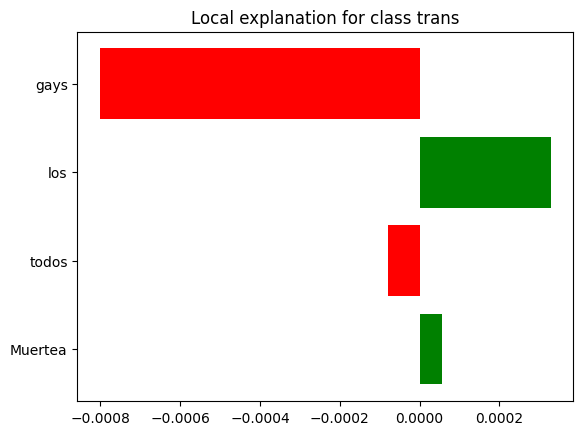

In [ ]:
print(exp.as_pyplot_figure())

#### SHAP

In [ ]:
import shap

In [ ]:
import re

def f(x):
    x = list(x)
    x = [ re.sub(r'\s+', ' ', re.sub(r'(\[MASK\])', r'', elem)).strip() for elem in x ]
    # print(x)
    inputs = tokenizer(list(x),
                      is_split_into_words = False,
                      truncation          = True,
                      max_length          = MAX_LENGTH,
                      padding             = 'max_length')

    inputs = {k: torch.tensor(v).cuda() for k, v in inputs.items() if k in ['input_ids', 'attention_mask']}

    outputs = model( **inputs )[0].detach()
    outputs = torch.nn.Softmax(-1)(outputs)

    return outputs[:,1]

In [ ]:
explainer = shap.Explainer(f, tokenizer, seed=43)

In [ ]:
shap_values = explainer(tokenized_dataset["test"][TEXT_COLNAME], fixed_context=None, max_evals=200)

PartitionExplainer explainer: 376it [05:40,  1.08it/s]


Summary plot

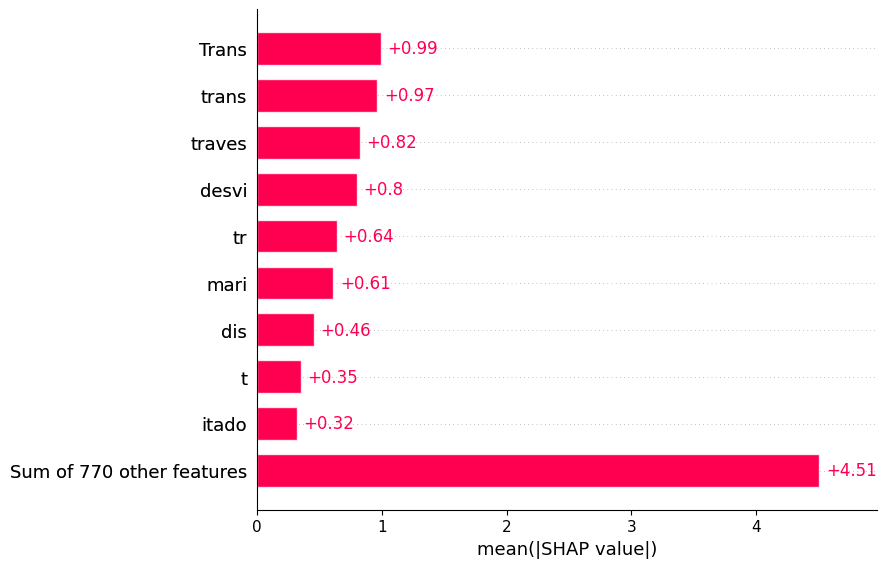

In [ ]:
shap.plots.bar(shap_values)

In [ ]:
shap.plots.text(shap_values)

Predicción individual A

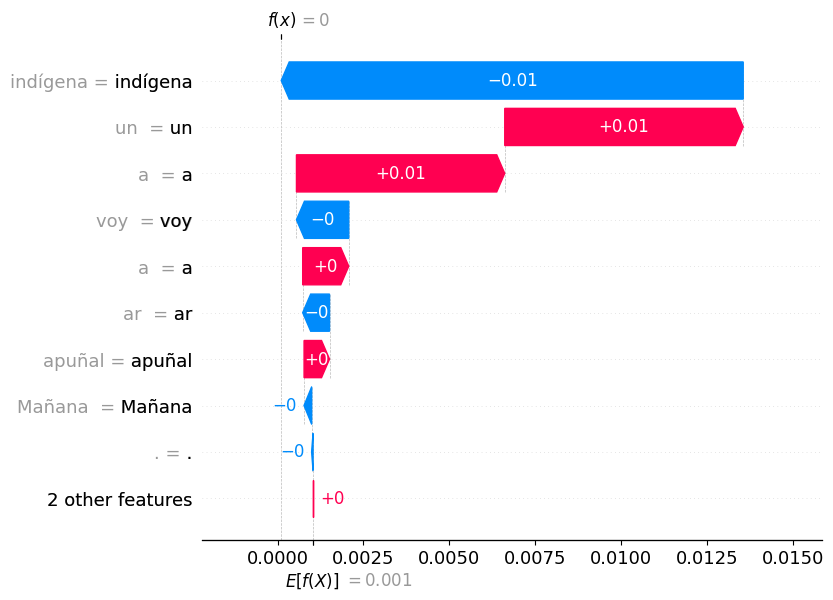

In [ ]:
shap.initjs()
ind = 3
shap.plots.waterfall(shap_values[ind], max_display=10)

In [ ]:
print(test_df[TEXT_COLNAME].iloc[ind])
print(test_df[LABEL_COLNAME].iloc[ind])

Mañana voy a apuñalar a un indígena.
0
